In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/birdcall-resnet50-init-weights/best.pth
/kaggle/input/birdsong-recognition/example_test_audio_metadata.csv
/kaggle/input/birdsong-recognition/sample_submission.csv
/kaggle/input/birdsong-recognition/train.csv
/kaggle/input/birdsong-recognition/test.csv
/kaggle/input/birdsong-recognition/example_test_audio_summary.csv
/kaggle/input/birdsong-recognition/example_test_audio/ORANGE-7-CAP_20190606_093000.pt623.mp3
/kaggle/input/birdsong-recognition/example_test_audio/BLKFR-10-CPL_20190611_093000.pt540.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC153881.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC423355.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC45484.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC109911.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC299486.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC474580.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC299484.mp3
/kaggle/input

**DOING EDA**

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import librosa
from sklearn.preprocessing import LabelEncoder
import librosa.display
import soundfile as sf 
import IPython.display as ipd 
from matplotlib.animation import FuncAnimation

In [3]:
data = pd.read_csv('/kaggle/input/birdsong-recognition/train.csv')
pd.set_option('display.max_column' , None)
pd.set_option('display.max_rows', None)  
pd.set_option('display.max_columns', None)
data.head()

,rating,playback_used,ebird_code,channels,date,pitch,duration,filename,speed,species,number_of_notes,title,secondary_labels,bird_seen,sci_name,location,latitude,sampling_rate,type,elevation,description,bitrate_of_mp3,file_type,volume,background,xc_id,url,country,author,primary_label,longitude,length,time,recordist,license
0,3.5,no,aldfly,1 (mono),2013-05-25,Not specified,25,XC134874.mp3,Not specified,Alder Flycatcher,Not specified,XC134874 Alder Flycatcher (Empidonax alnorum),"['Empidonax minimus_Least Flycatcher', 'Leioth...",yes,Empidonax alnorum,"Grey Cloud Dunes SNA, Washington, Minnesota",44.793,48000 (Hz),call,220 m,Two short segments of fairly quiet *pip* calls...,192000 (bps),mp3,Not specified,American Yellow Warbler (Setophaga aestiva); L...,134874,https://www.xeno-canto.org/134874,United States,Jonathon Jongsma,Empidonax alnorum_Alder Flycatcher,-92.962,Not specified,8:00,Jonathon Jongsma,Creative Commons Attribution-ShareAlike 3.0
1,4.0,no,aldfly,2 (stereo),2013-05-27,both,36,XC135454.mp3,both,Alder Flycatcher,1-3,XC135454 Alder Flycatcher (Empidonax alnorum),[],yes,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,At least three birds seen here moving around s...,128000 (bps),mp3,level,NaN,135454,https://www.xeno-canto.org/135454,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...
2,4.0,no,aldfly,2 (stereo),2013-05-27,both,39,XC135455.mp3,both,Alder Flycatcher,1-3,XC135455 Alder Flycatcher (Empidonax alnorum),[],yes,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,At least three birds seen chasing each other a...,128000 (bps),mp3,level,NaN,135455,https://www.xeno-canto.org/135455,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...
3,3.5,no,aldfly,2 (stereo),2013-05-27,both,33,XC135456.mp3,both,Alder Flycatcher,1-3,XC135456 Alder Flycatcher (Empidonax alnorum),"['Dumetella carolinensis_Gray Catbird', 'Bomby...",yes,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,img:http://www.flickr.com/photos/madbirder/888...,128000 (bps),mp3,level,Grey Catbird (Dumetella carolinensis); Cedar W...,135456,https://www.xeno-canto.org/135456,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...
4,4.0,no,aldfly,2 (stereo),2013-05-27,both,36,XC135457.mp3,level,Alder Flycatcher,1-3,XC135457 Alder Flycatcher (Empidonax alnorum),[],yes,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,img:http://www.flickr.com/photos/madbirder/888...,128000 (bps),mp3,level,NaN,135457,https://www.xeno-canto.org/135457,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21375 entries, 0 to 21374
Data columns (total 35 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   rating            21375 non-null  float64
 1   playback_used     19575 non-null  object 
 2   ebird_code        21375 non-null  object 
 3   channels          21375 non-null  object 
 4   date              21375 non-null  object 
 5   pitch             21375 non-null  object 
 6   duration          21375 non-null  int64  
 7   filename          21375 non-null  object 
 8   speed             21375 non-null  object 
 9   species           21375 non-null  object 
 10  number_of_notes   21375 non-null  object 
 11  title             21375 non-null  object 
 12  secondary_labels  21375 non-null  object 
 13  bird_seen         19575 non-null  object 
 14  sci_name          21375 non-null  object 
 15  location          21375 non-null  object 
 16  latitude          21375 non-null  object

In [5]:
null_columns = data.columns[data.isnull().any()]
null_columns

Index(['playback_used', 'bird_seen', 'description', 'bitrate_of_mp3',
       'background'],
      dtype='object')

In [6]:
data['rating'].unique()

array([3.5, 4. , 4.5, 5. , 3. , 2.5, 1.5, 1. , 2. , 0.5, 0. ])

In [7]:
data['playback_used'].unique()

array(['no', nan, 'yes'], dtype=object)

In [8]:
data['playback_used'].value_counts(dropna=False)

playback_used
no     18964
NaN     1800
yes      611
Name: count, dtype: int64

In [9]:
data['playback_used'].fillna('no' , inplace=True)

In [10]:
data['ebird_code'].nunique()

264

In [11]:
data['channels'].unique()

array(['1 (mono)', '2 (stereo)'], dtype=object)

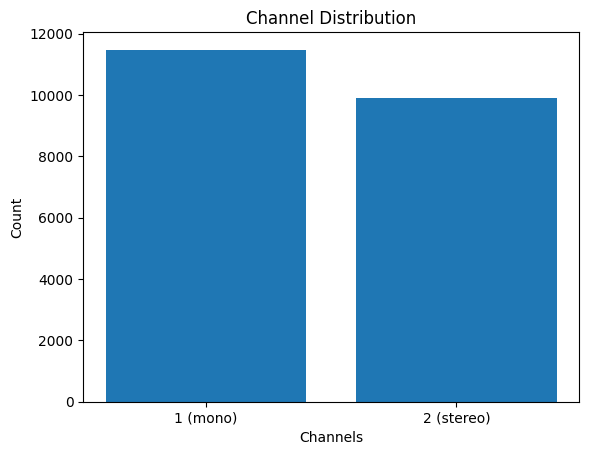

In [12]:
channel_counts = data['channels'].value_counts()
# Plot a bar graph
plt.bar(channel_counts.index, channel_counts.values)

# Set plot labels and title
plt.xlabel('Channels')
plt.ylabel('Count')
plt.title('Channel Distribution')

# Show the plot
plt.show()

<Axes: xlabel='rating', ylabel='count'>

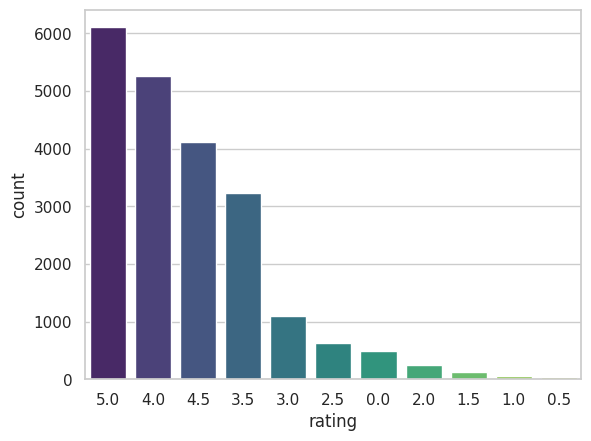

In [13]:
sns.set(style="whitegrid")  # Set the background style

# Define a custom color palette
custom_palette = sns.color_palette("viridis", n_colors=len(data['rating'].unique()))

sns.countplot(x='rating', data=data, order=data['rating'].value_counts().index, palette=custom_palette)

In [14]:
data['channels'] = data['channels'].astype(str).str[0].astype(int)
data['channels'].unique()

array([1, 2])

In [15]:
data['date'].unique()

array(['2013-05-25', '2013-05-27', '2013-05-30', ..., '2009-05-07',
       '2019-01-04', '2019-09-25'], dtype=object)

In [16]:
data['year'] = data['date'].apply(lambda x : x.split('-')[0]).astype(int)
data['month'] = data['date'].apply(lambda x : x.split('-')[1]).astype(int)
data['day'] = data['date'].apply(lambda x : x.split('-')[2]).astype(int)
data = data.drop(['date'] , axis=1)
data.head()

,rating,playback_used,ebird_code,channels,pitch,duration,filename,speed,species,number_of_notes,title,secondary_labels,bird_seen,sci_name,location,latitude,sampling_rate,type,elevation,description,bitrate_of_mp3,file_type,volume,background,xc_id,url,country,author,primary_label,longitude,length,time,recordist,license,year,month,day
0,3.5,no,aldfly,1,Not specified,25,XC134874.mp3,Not specified,Alder Flycatcher,Not specified,XC134874 Alder Flycatcher (Empidonax alnorum),"['Empidonax minimus_Least Flycatcher', 'Leioth...",yes,Empidonax alnorum,"Grey Cloud Dunes SNA, Washington, Minnesota",44.793,48000 (Hz),call,220 m,Two short segments of fairly quiet *pip* calls...,192000 (bps),mp3,Not specified,American Yellow Warbler (Setophaga aestiva); L...,134874,https://www.xeno-canto.org/134874,United States,Jonathon Jongsma,Empidonax alnorum_Alder Flycatcher,-92.962,Not specified,8:00,Jonathon Jongsma,Creative Commons Attribution-ShareAlike 3.0,2013,5,25
1,4.0,no,aldfly,2,both,36,XC135454.mp3,both,Alder Flycatcher,1-3,XC135454 Alder Flycatcher (Empidonax alnorum),[],yes,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,At least three birds seen here moving around s...,128000 (bps),mp3,level,NaN,135454,https://www.xeno-canto.org/135454,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...,2013,5,27
2,4.0,no,aldfly,2,both,39,XC135455.mp3,both,Alder Flycatcher,1-3,XC135455 Alder Flycatcher (Empidonax alnorum),[],yes,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,At least three birds seen chasing each other a...,128000 (bps),mp3,level,NaN,135455,https://www.xeno-canto.org/135455,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...,2013,5,27
3,3.5,no,aldfly,2,both,33,XC135456.mp3,both,Alder Flycatcher,1-3,XC135456 Alder Flycatcher (Empidonax alnorum),"['Dumetella carolinensis_Gray Catbird', 'Bomby...",yes,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,img:http://www.flickr.com/photos/madbirder/888...,128000 (bps),mp3,level,Grey Catbird (Dumetella carolinensis); Cedar W...,135456,https://www.xeno-canto.org/135456,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...,2013,5,27
4,4.0,no,aldfly,2,both,36,XC135457.mp3,level,Alder Flycatcher,1-3,XC135457 Alder Flycatcher (Empidonax alnorum),[],yes,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,img:http://www.flickr.com/photos/madbirder/888...,128000 (bps),mp3,level,NaN,135457,https://www.xeno-canto.org/135457,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...,2013,5,27


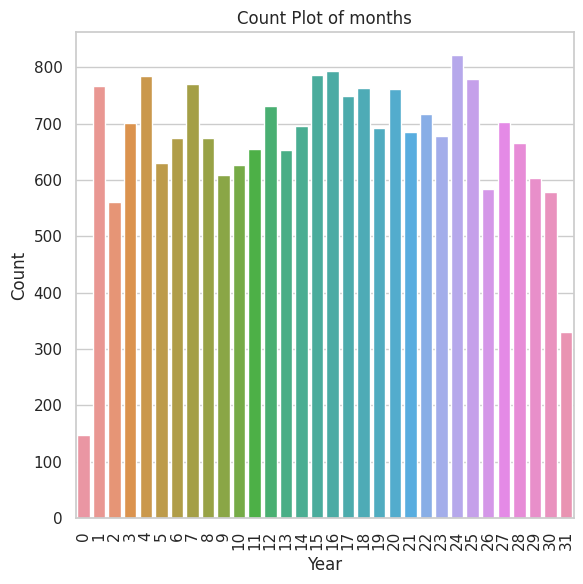

In [17]:
plt.figure(figsize=(6,6))
sns.countplot(x='day', data=data)

plt.xticks(rotation =90)
plt.title('Count Plot of months')
plt.xlabel('Year')
plt.ylabel('Count')
plt.tight_layout()
plt.show()

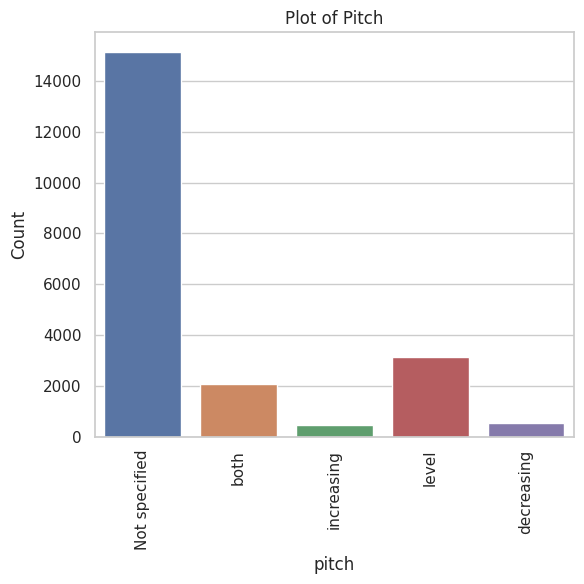

In [18]:

plt.figure(figsize=(6,6))
sns.countplot(x='pitch', data=data)

plt.xticks(rotation =90)
plt.title('Plot of Pitch')
plt.xlabel('pitch')
plt.ylabel('Count')
plt.tight_layout()
plt.show()

In [19]:
train = data.iloc[[0 ,1 , 1147 , 1148 , 4754 , 4755 , 7221 , 7222 , 21088 , 21089]].reset_index(drop=True)
train.head(10)

,rating,playback_used,ebird_code,channels,pitch,duration,filename,speed,species,number_of_notes,title,secondary_labels,bird_seen,sci_name,location,latitude,sampling_rate,type,elevation,description,bitrate_of_mp3,file_type,volume,background,xc_id,url,country,author,primary_label,longitude,length,time,recordist,license,year,month,day
0,3.5,no,aldfly,1,Not specified,25,XC134874.mp3,Not specified,Alder Flycatcher,Not specified,XC134874 Alder Flycatcher (Empidonax alnorum),"['Empidonax minimus_Least Flycatcher', 'Leioth...",yes,Empidonax alnorum,"Grey Cloud Dunes SNA, Washington, Minnesota",44.793,48000 (Hz),call,220 m,Two short segments of fairly quiet *pip* calls...,192000 (bps),mp3,Not specified,American Yellow Warbler (Setophaga aestiva); L...,134874,https://www.xeno-canto.org/134874,United States,Jonathon Jongsma,Empidonax alnorum_Alder Flycatcher,-92.962,Not specified,8:00,Jonathon Jongsma,Creative Commons Attribution-ShareAlike 3.0,2013,5,25
1,4.0,no,aldfly,2,both,36,XC135454.mp3,both,Alder Flycatcher,1-3,XC135454 Alder Flycatcher (Empidonax alnorum),[],yes,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,At least three birds seen here moving around s...,128000 (bps),mp3,level,NaN,135454,https://www.xeno-canto.org/135454,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...,2013,5,27
2,5.0,no,baisan,1,Not specified,19,XC147069.mp3,Not specified,Baird's Sandpiper,Not specified,XC147069 Baird's Sandpiper (Calidris bairdii),[],yes,Calidris bairdii,"Lago Uru Uru, Oruro",-18.0427,48000 (Hz),call,3700 m,natural vocalization; 'whistle' calls from a s...,320000 (bps),mp3,Not specified,NaN,147069,https://www.xeno-canto.org/147069,Bolivia,Andrew Spencer,Calidris bairdii_Baird's Sandpiper,-67.0846,Not specified,07:10,Andrew Spencer,Creative Commons Attribution-NonCommercial-Sha...,2013,8,22
3,5.0,no,baisan,1,Not specified,17,XC147070.mp3,Not specified,Baird's Sandpiper,Not specified,XC147070 Baird's Sandpiper (Calidris bairdii),[],yes,Calidris bairdii,"Lago Uru Uru, Oruro",-18.0427,48000 (Hz),call,3700 m,natural vocalization; typical flight calls fro...,320000 (bps),mp3,Not specified,NaN,147070,https://www.xeno-canto.org/147070,Bolivia,Andrew Spencer,Calidris bairdii_Baird's Sandpiper,-67.0846,Not specified,07:10,Andrew Spencer,Creative Commons Attribution-NonCommercial-Sha...,2013,8,22
4,2.5,no,camwar,1,Not specified,158,XC133791.mp3,Not specified,Cape May Warbler,Not specified,XC133791 Cape May Warbler (Setophaga tigrina),"['Icterus galbula_Baltimore Oriole', 'Setophag...",yes,Setophaga tigrina,"Garret Mountain Reservation, Passaic Co., NJ",40.899,44100 (Hz),song,100 m,Natural song (competing with loud S. fusca son...,128000 (bps),mp3,Not specified,Baltimore Oriole (Icterus galbula); Black-thro...,133791,https://www.xeno-canto.org/133791,United States,Dan Lane,Setophaga tigrina_Cape May Warbler,-74.182,Not specified,09:00,Dan Lane,Creative Commons Attribution-NonCommercial-Sha...,2013,5,15
5,3.5,no,camwar,1,Not specified,38,XC134013.mp3,Not specified,Cape May Warbler,Not specified,XC134013 Cape May Warbler (Setophaga tigrina),"['Pipilo erythrophthalmus_Eastern Towhee', 'Vi...",yes,Setophaga tigrina,"Garret Mountain Reservation, Passaic Co., NJ",40.899,44100 (Hz),song,100 m,Natural songs from a migrant in deciduous wood...,128000 (bps),mp3,Not specified,Eastern Towhee (Pipilo erythrophthalmus); Red-...,134013,https://www.xeno-canto.org/134013,United States,Dan Lane,Setophaga tigrina_Cape May Warbler,-74.182,Not specified,?,Dan Lane,Creative Commons Attribution-NonCommercial-Sha...,1993,5,3
6,4.0,no,dusfly,1,both,83,XC104535.mp3,level,American Dusky Flycatcher,4-6,XC104535 American Dusky Flycatcher (Empidonax ...,[],yes,Empidonax oberholseri,"Blue Bell Campground, Custer State Park, Sout...",43.719,44100 (Hz),song,1500 m,Natural song from a bird across the creek from...,128000 (bps),mp3,l

**Feature Engineering**

In [20]:
base_directory = '/kaggle/input/birdsong-recognition/train_audio/'

# Create a new column 'file_location' by combining 'category' and 'file_name'
audio = base_directory + train['ebird_code'] + '/' + train['filename']
audio

0    /kaggle/input/birdsong-recognition/train_audio...
1    /kaggle/input/birdsong-recognition/train_audio...
2    /kaggle/input/birdsong-recognition/train_audio...
3    /kaggle/input/birdsong-recognition/train_audio...
4    /kaggle/input/birdsong-recognition/train_audio...
5    /kaggle/input/birdsong-recognition/train_audio...
6    /kaggle/input/birdsong-recognition/train_audio...
7    /kaggle/input/birdsong-recognition/train_audio...
8    /kaggle/input/birdsong-recognition/train_audio...
9    /kaggle/input/birdsong-recognition/train_audio...
dtype: object

In [21]:
y_list = []
sr_list = []

# Loop through the 'audio' column and load each audio file
for audio_file in audio:
    y_, sr_ = librosa.load(audio_file)
    y_list.append(y_)
    sr_list.append(sr_)

# Add 'y' and 'sr' columns to the DataFrame
train['y'] = y_list
train['sr'] = sr_list

In [22]:
for i in range(10):
    print(f"Audio {i}: {train.loc[i, 'ebird_code']}")
    ipd.display(ipd.Audio(train.loc[i, 'y'], rate=train.loc[i, 'sr']))

Audio 0: aldfly


Audio 1: aldfly


Audio 2: baisan


Audio 3: baisan


Audio 4: camwar


Audio 5: camwar


Audio 6: dusfly


Audio 7: dusfly


Audio 8: yelwar


Audio 9: yelwar


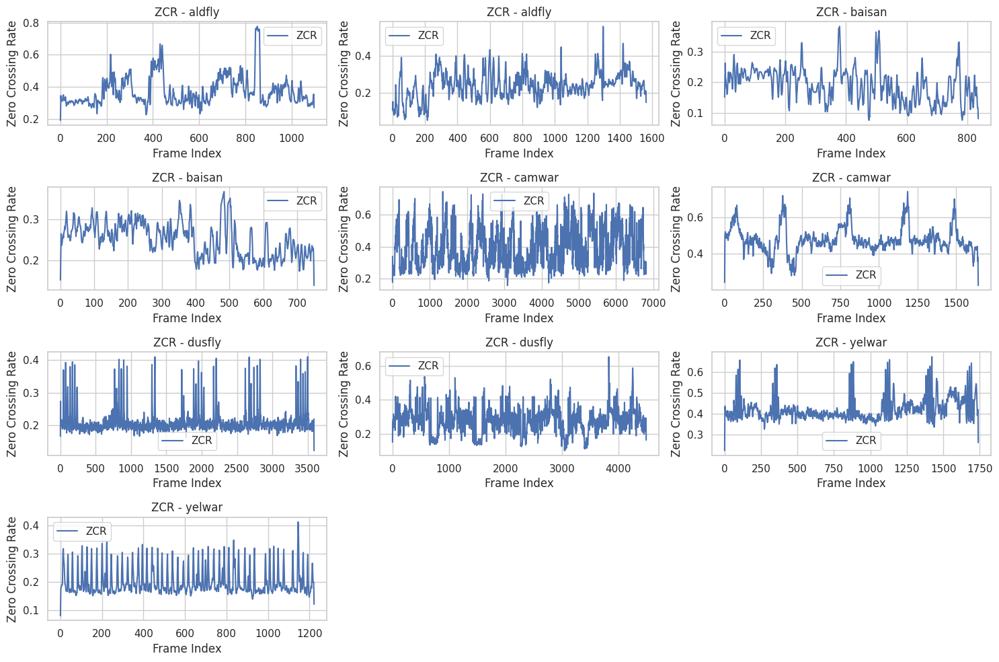

In [23]:
train['zcr'] = None

# Loop through the DataFrame and calculate zero-crossing rates for each audio file
for i in range(len(train)):
    y = train.loc[i, 'y']
    zcr = librosa.feature.zero_crossing_rate(y)
    train.at[i, 'zcr'] = zcr

# Plot Zero Crossing Rate for all audio files
num_files_to_plot = 10  # Change this based on the number of files you want to plot
plt.figure(figsize=(15, 10))

for i in range(num_files_to_plot):
    zcr_values = train.loc[i, 'zcr'][0]
    plt.subplot(4, 3, i+1)  # Assuming you want a 2x5 grid for the first 10 files
    plt.plot(zcr_values, label='ZCR')
    plt.title(f'ZCR - {train.loc[i, "ebird_code"]}')
    plt.legend()
    plt.xlabel('Frame Index')
    plt.ylabel('Zero Crossing Rate')

plt.tight_layout()
plt.show()

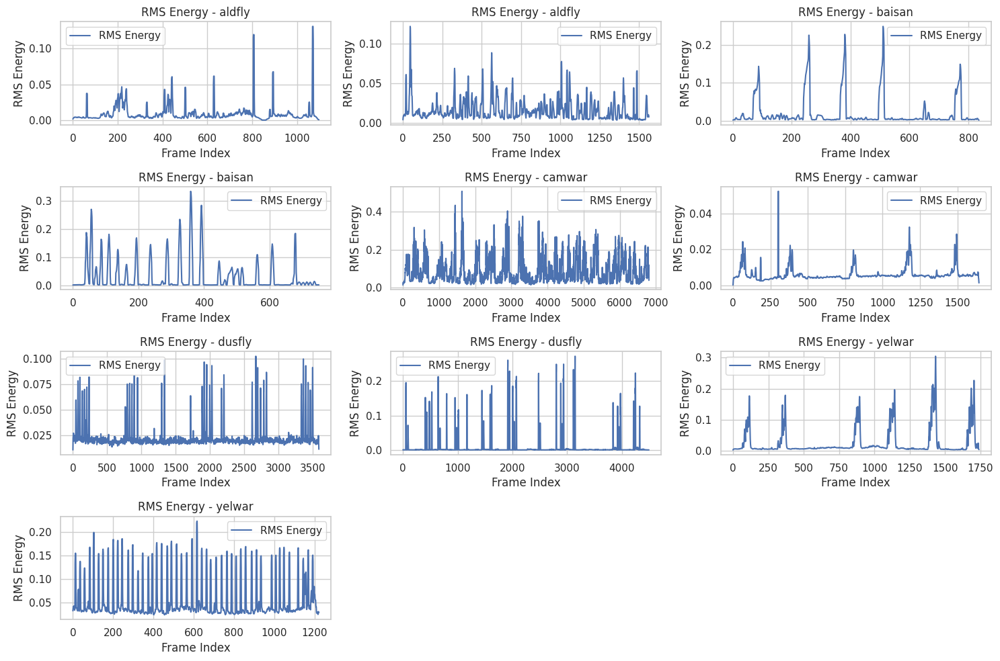

In [24]:
train['rms_energy'] = None

for i in range(len(train)):
    y = train.loc[i, 'y']
    rms_energy = librosa.feature.rms(y=y)
    train.at[i, 'rms_energy'] = rms_energy

# Plot RMS Energy for all audio files
num_files_to_plot = 10  # Change this based on the number of files you want to plot
plt.figure(figsize=(15, 10))

for i in range(num_files_to_plot):
    rms_energy_values = train.loc[i, 'rms_energy'][0]
    plt.subplot(4, 3, i+1)  # Assuming you want a 2x5 grid for the first 10 files
    plt.plot(rms_energy_values, label='RMS Energy')
    plt.title(f'RMS Energy - {train.loc[i, "ebird_code"]}')
    plt.legend()
    plt.xlabel('Frame Index')
    plt.ylabel('RMS Energy')

plt.tight_layout()
plt.show()

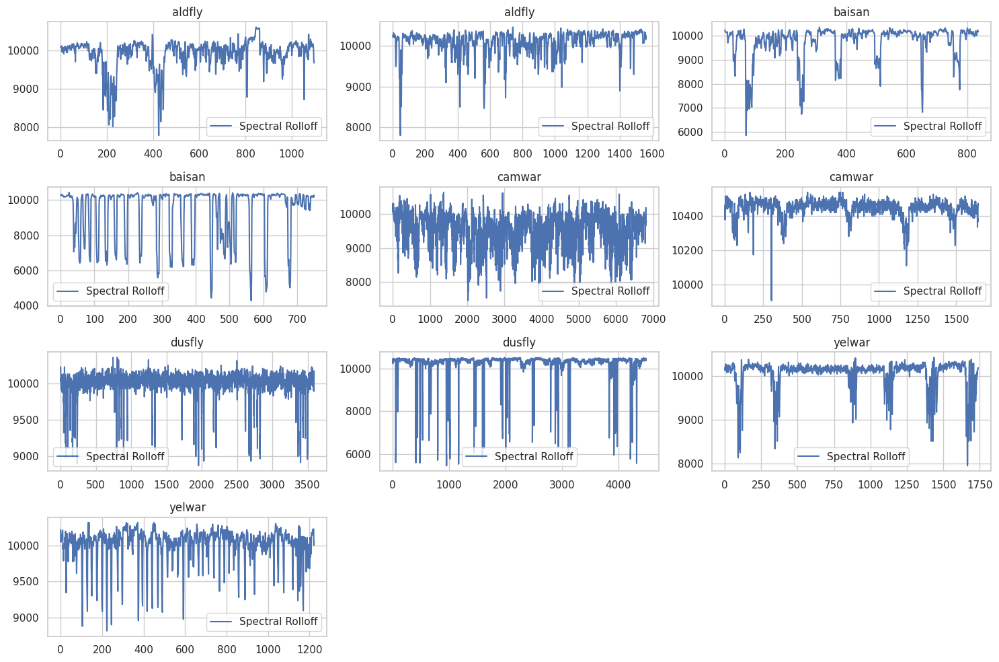

In [25]:
def plot_spectral_rolloff(y, sr, title):
    S, phase = librosa.magphase(librosa.stft(y))
    rolloff = librosa.feature.spectral_rolloff(S=S, sr=sr, roll_percent=0.99)

    # Plot Spectral Rolloff
    plt.plot(rolloff[0], label='Spectral Rolloff')
    plt.title(f'{title}')
    plt.legend()

# Plot Spectral Rolloff for all audio files
num_files_to_plot = 10  # Change this based on the number of files you want to plot
plt.figure(figsize=(15, 10))

for i in range(num_files_to_plot):
    plt.subplot(4, 3, i+1)  # Assuming you want a 2x5 grid for the first 10 files
    plot_spectral_rolloff(train.loc[i, 'y'], train.loc[i, 'sr'], f'{train.loc[i, "ebird_code"]}')

plt.tight_layout()
plt.show()

**Model Building**

In [26]:
!pip install resampy

ERROR: Could not find a version that satisfies the requirement resampy (from versions: none)
ERROR: No matching distribution found for resampy


In [27]:
import cv2
import audioread
import logging
import os
import random
import time
import warnings

import resampy
import librosa
import numpy as np
import pandas as pd
import soundfile as sf
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as data

from contextlib import contextmanager
from pathlib import Path
from typing import Optional

from fastprogress import progress_bar
from sklearn.metrics import f1_score
from torchvision import models

ModuleNotFoundError: No module named 'resampy'

In [ ]:
def setseed(seed: int=42):
    random.seed(seed)
    np.random.seed(seed)
    os.environ["PYTHONHASHSEED"]= str(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic=True
    torch.backends.cudnn.benchmark=True
    
def get_logger(out_file=None):
    logger=logging.getLogger()
    formatter=logging.Formatter("%(asctime)s-%(levelname)s-%(message)s")
    logger.handlers=[]
    logger.setLevel=(logging.INFO)
    
    handler=logging.StreamHandler()
    handler.setFormatter(formatter)
    handler.setLevel(logging.INFO)
    logger.addHandler(handler)
    
    if out_file is not None:
        fh=logging.FileHandler(out_file)
        fh.setFormatter(formatter)
        fh.setLevel(logging.INFO)
        logger.addHandler(fh)
    logger.info("logger set up")
    return logger

@contextmanager

def timer(name: str,logger: Optional[logging.Logger]=None):
    t0=time.time()
    msg=f"[{name}]start"
    if logger is None:
        print(msg)
    else:
        logger.info(msg)
    yield
    msg=f"[{name}] done in {time.time()-t0:.2f}s"
    if logger is None:
        print(msg)
    else:
        logger.info(msg)

In [ ]:
logger=get_logger("main.log")
setseed(1213)

In [ ]:
test= pd.read_csv("/kaggle/input/birdcall-check/test.csv")
test_audio="/kaggle/input/birdcall-check/test_audio"

test.head()

In [ ]:
class ResNet(nn.Module):
    def __init__(self, base_model_name:str, pretrained=False,num_classes=264):
        super().__init__()
        base_model=models.__getattribute__(base_model_name)(pretrained=pretrained)
        layers=list(base_model.children())[:-2]
        layers.append(nn.AdaptiveMaxPool2d(1))
        self.encoder=nn.Sequential(*layers)
        
        in_features=base_model.fc.in_features
        
        self.classifier=nn.Sequential(
             nn.Linear(in_features,1024),nn.ReLU(),nn.Dropout(p=0.2),
             nn.Linear(1024,1024),nn.ReLU(),nn.Dropout(p=0.2),
             nn.Linear(1024,num_classes))
        
    def forward(self,x):
        batch_size=x.size(0)
        x=self.encoder(x).view(batch_size,-1)
        x=self.classifier(x)
        multiclass_p=F.softmax(x,dim=1)
        multilabel_p=F.sigmoid(x)
        return{
            "logits":x,
            "multiclass_p":multiclass_p,
            "multilabel_p":multilabel_p
        }

In [ ]:
model_config={
    "base_model_name":"resnet50",
    "pretrained":False,
    "num_classes":264
}

melspectrogram_parameters={
    "n_mels":128,
    "fmin":20,
    "fmax":16000
}

weights_path="/kaggle/input/birdcall-resnet50-init-weights/best.pth"

In [ ]:
from sklearn.preprocessing import LabelEncoder
df=pd.read_csv("/kaggle/input/birdsong-recognition/train.csv")
unique_bird_names=df.ebird_code.unique()
labelencoder=LabelEncoder()
encoded_labels=labelencoder.fit_transform(unique_bird_names)

BIRD_CODE=dict(zip(unique_bird_names,encoded_labels))
INV_BIRD_CODE={v:k for k,v in BIRD_CODE.items()}

for bird_name,label in INV_BIRD_CODE.items():
    print(f"{bird_name}:{label}")

In [ ]:
def mono_to_color(X:np.ndarray,
                  mean=None,
                  std=None,
                  norm_max=None,
                  norm_min=None,
                  eps=1e-6):
    X=np.stack([X,X,X],axis=-1)
    
    mean=mean or X.mean()
    X=X-mean
    std=std or X.std()
    Xstd=X/(std+eps)
    _min,_max=Xstd.min(),Xstd.max()
    norm_max=norm_max or _max
    norm_min=norm_min or _min
    
    if(_max-_min)>eps:
        V=Xstd
        V[V<norm_min]=norm_min
        V[V>norm_max]=norm_max
        V=255*(V-norm_min)/(norm_max-norm_min)
        V=V.astype(np.uint8)
    else:
        V=np.zeroes_like(Xstd,dtype=np.uint8)
    return V

In [ ]:
class TestDataset(data.Dataset):
    def __init__(self, df:pd.DataFrame, clip:np.ndarray,img_size=224, melspectrogram_parameters={}):
        self.df=df
        self.clip=clip
        self.img_size=img_size
        self.melspectrogram_parameters=melspectrogram_parameters
        
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self, idx:int):
        SR=32000
        sample=self.df.loc[idx,:]
        site=sample.site
        row_id=sample.row_id
        
        if site=="site_3":
            y=self.clip.astype(np.float32)
            len_y=len(y)
            start=0
            end=SR*5
            images=[]
            while len_y>start:
                y_batch=y[start:end].astype(np.float32)
                if len(y_batch)!=(SR*5):
                    break
                start=end
                end=end+SR*5
                melspec=librosa.feature.melspectrogram(y=y_batch,sr=32000,**self.melspectrogram_parameters)
                melspec=librosa.power_to_db(melspec).astype(np.float32)
                image=mono_to_color(melspec)
                height,width,_=image.shape
                image=cv2.resize(image,(int(width*self.img_size/height),self.img_size))
                image=np.moveaxis(image,2,0)
                image=(image/255.0).astype(np.float32)
                images.append(image)
            images=np.asarray(images)
            return images,row_id,site
        
        else:
            end_seconds=int(sample.seconds)
            start_seconds=int(end_seconds-5)
            
            start_index=SR*start_seconds
            end_index=SR*end_seconds
            
            y=self.clip[start_index:end_index].astype(np.float32)
            melspec=librosa.feature.melspectrogram(y=y,sr=32000,**self.melspectrogram_parameters)
            melspec=librosa.power_to_db(melspec).astype(np.float32)
            image=mono_to_color(melspec)
            height,width,_=image.shape
            image=cv2.resize(image,(int(width*self.img_size/height),self.img_size))
            image=np.moveaxis(image,2,0)
            image=(image/255.0).astype(np.float32)
            
            return image,row_id,site

In [ ]:
def get_model(config: dict, weights_path: str):
    model = ResNet(**config)
    checkpoint = torch.load(weights_path, map_location=torch.device('cpu'))
    model.load_state_dict(checkpoint["model_state_dict"])
    model.eval()
    return model

Prediction and analysis


In [ ]:
def prediction_for_clip(test_df: pd.DataFrame,
                        clip:np.ndarray,
                        model:ResNet,
                        mel_params:dict,
                        threshold=0.5):
    dataset=TestDataset(df=test_df,
                       clip=clip,
                       img_size=224,
                       melspectrogram_parameters=mel_params)
    loader=data.DataLoader(dataset,batch_size=1,shuffle=False)
    device=torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    model.eval()
    prediction_dict={}
    for image,row_id,site in progress_bar(loader):
        site=site[0]
        row_id=row_id[0]
        if site in {"site_1","site_2"}:
            image=image.to(device)
            
            with torch.no_grad():
                prediction=model(image)
                proba=prediction["multilabel_p"].detach().cpu().numpy().reshape(-1)
                
            events=proba>=threshold
            labels=np.argwhere(events).reshape(-1).tolist()
            
        else:
            image=image.squeeze(0)
            batch_size=16
            whole_size=image.size(0)
            if whole_size % batch_size==0:
                n_iter=whole_size//batch_size
            else:
                n_iter=whole_size//batch_size+1
                
                
            all_events=set()
            for batch_i in range(n_iter):
                batch=image[batch_i*batch_size:(batch_i+1)*batch_size]
                if batch.ndim==3:
                    batch=batch.unsqueeze(0)
                    
                batch=batch.to(device)
                with torch.no_grad():
                    prediction=model(batch)
                    proba=prediction["multilabel_p"].detach().cpu().numpy()
                events=proba>=threshold
                
                for i in range(len(events)):
                    event=events[i,:]
                    labels=np.argwhere(event).reshape(-1).tolist()
                    for label in labels:
                        all_events.add(label)
            labels=list(all_events)
        
        if len(labels)==0:
            prediction_dict[row_id]="nocall"
            
        else:
            labels_str_list=list(map(lambda x: INV_BIRD_CODE[x],labels))
            label_string=" ".join(labels_str_list)
            prediction_dict[row_id]=label_string
    return prediction_dict

In [ ]:
def prediction(test_df:pd.DataFrame,
              test_audio:Path,
              model_config:dict,
              mel_params:dict,
              weights_path:str,
              threshold=0.5):
    model=get_model(model_config, weights_path)
    unique_audio_id=test_df.audio_id.unique()
    
    warnings.filterwarnings("ignore")
    prediction_dfs=[]
    for audio_id in unique_audio_id:
        with timer(f"Loading {audio_id}", logger):
            clip,_=librosa.load(test_audio+"/"+(audio_id+".mp3"),
                                sr=32000,
                                mono=True,
                                res_type="scipy")
        test_df_for_audio_id=test_df.query(f"audio_id=='{audio_id}'").reset_index(drop=True)
        with timer(f"Prediction on {audio_id}", logger):
            prediction_dict=prediction_for_clip(test_df_for_audio_id,
                                               clip=clip,
                                               model=model,
                                               mel_params=mel_params,
                                               threshold=threshold)
        row_id=list(prediction_dict.keys())
        birds=list(prediction_dict.values())
        prediction_df=pd.DataFrame({
            "row_id":row_id,
            "birds":birds
        })
        prediction_dfs.append(prediction_df)
    prediction_df=pd.concat(prediction_dfs, axis=0,sort=False).reset_index(drop=True)
    return prediction_df

In [ ]:
submission=prediction(test_df=test,
                     test_audio=test_audio,
                     model_config=model_config,
                     mel_params= melspectrogram_parameters,
                     weights_path=weights_path,
                     threshold=0.8)
submission.to_csv("submission.csv", index=False)